# Data Augmentation

In [1]:
"""
Generate the files with background sound.
    
@author: Juan Felipe Latorre Gil - jflatorreg@unal.edu.co
"""

import numpy as np 
import pandas as pd 
import librosa, librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd
from time import process_time
from scipy.io.wavfile import write
from pathlib import Path

In [2]:
def get_spectrogram(wav):
    D = librosa.stft(wav, n_fft=480, hop_length=160,
                     win_length=480, window='hamming')
    spect, phase = librosa.magphase(D)
    return spect

In [3]:
sr = 22050

In [4]:
file_path_background = './BOG_lluvia_goteo_balcon_mono.wav'

In [5]:
wav_background, sr_background = librosa.load(file_path_background, sr=None)

In [6]:
ipd.Audio(wav_background, rate=sr_background)

In [7]:
sr_background

44100

In [8]:
wav_background = librosa.resample(wav_background, sr_background, sr)

spectrogram shape: (241, 16733)


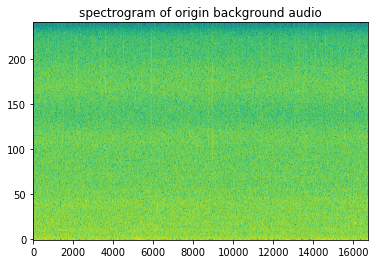

In [9]:
log_spect = np.log(get_spectrogram(wav_background))
print('spectrogram shape:', log_spect.shape)
plt.imshow(log_spect, aspect='auto', origin='lower',)
plt.title('spectrogram of origin background audio')
plt.show()

In [10]:
ipd.Audio(wav_background, rate=sr)

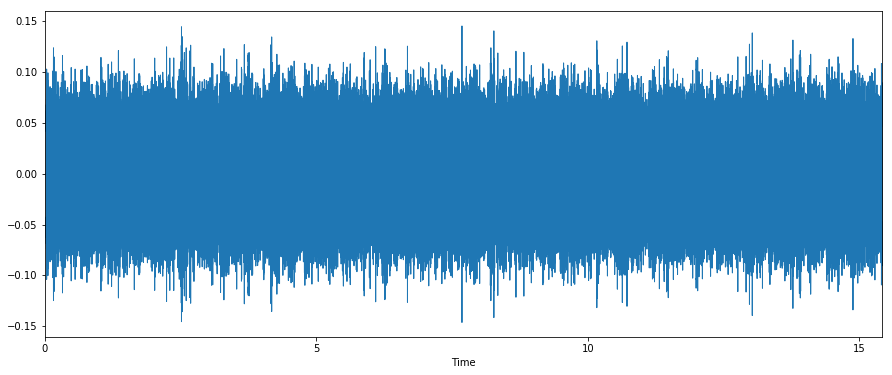

In [12]:
plt.figure(figsize=(15, 6))
wav_background = wav_background[:340000]
librosa.display.waveplot(wav_background)

In [14]:
wav_background_invert = np.asfortranarray(wav_background[::-1])

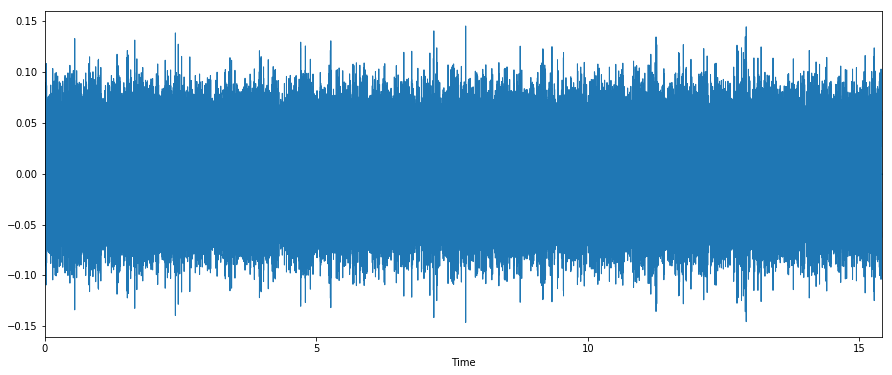

In [15]:
plt.figure(figsize=(15, 6))
librosa.display.waveplot(wav_background_invert)

In [16]:
wav_background = np.append(wav_background, [wav_background_invert,wav_background,wav_background_invert,
                                            wav_background_invert,wav_background,wav_background_invert,
                                            wav_background])

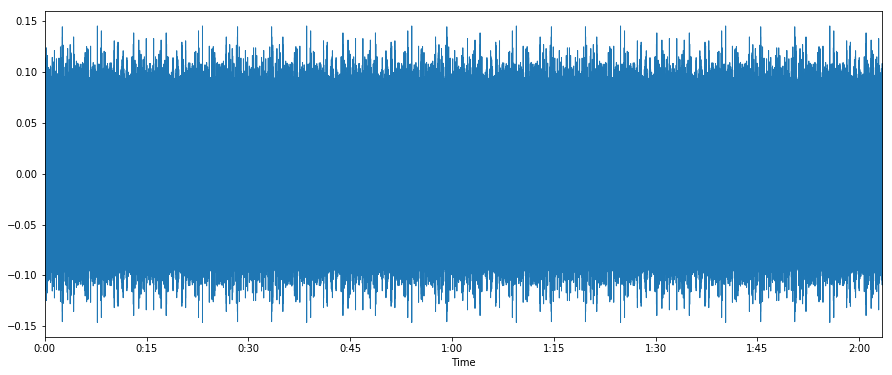

In [17]:
plt.figure(figsize=(15, 6))
librosa.display.waveplot(wav_background)

spectrogram shape: (241, 17001)


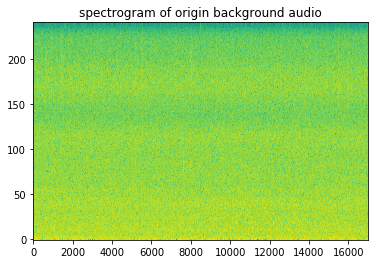

In [18]:
log_spect = np.log(get_spectrogram(wav_background))
print('spectrogram shape:', log_spect.shape)
plt.imshow(log_spect, aspect='auto', origin='lower',)
plt.title('spectrogram of origin background audio')
plt.show()

In [19]:
ipd.Audio(wav_background, rate=sr)

## Generate files

In [20]:
train_files = [
    path.name for path in Path().glob('./train/*.wav')
]
len(train_files)

312

In [21]:
for file in train_files:
    wav, sr = librosa.load('./train/'+file, sr=None)
    wav_background_short = wav_background[:len(wav)]
    wav_background_short_normalize = wav_background_short * (1/np.amax(wav_background_short))
    wav = wav * (1/np.amax(wav))
    wav = (0.2 * wav_background_short_normalize) +  wav
    #write('./data_augmentation/set_1/'+ file, sr, wav)

In [22]:
for file in train_files:
    wav, sr = librosa.load('./train/'+file, sr=None)
    wav_background_short = wav_background[:len(wav)]
    wav_background_short_normalize = wav_background_short * (1/np.amax(wav_background_short))
    wav = wav * (1/np.amax(wav))
    wav = (0.35 * wav_background_short_normalize) +  wav
    #write('./data_augmentation/set_2/'+ file, sr, wav)

In [23]:
for file in train_files:
    wav, sr = librosa.load('./train/'+file, sr=None)
    wav_background_short = wav_background[:len(wav)]
    wav_background_short_normalize = wav_background_short * (1/np.amax(wav_background_short))
    wav = wav * (1/np.amax(wav))
    wav = (0.5 * wav_background_short_normalize) +  wav
    #write('./data_augmentation/set_3/'+ file, sr, wav)